<a href="https://colab.research.google.com/github/MarkusStefan/Data_Analytics/blob/main/Ex5/HeuristicOptimization_NeuralNetworks.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# The fifth exercise is about heuristic optimization and AI/ML.



In [1]:
!pip install pyswarm
!pip install ann_visualizer
!pip install visualkeras
!pip install graphviz
import graphviz
import visualkeras
import os
from google.colab.patches import cv2_imshow
import cv2
from ann_visualizer.visualize import ann_viz
from PIL import ImageFont
import pyswarm
from google.colab import output
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans
from scipy.optimize import differential_evolution
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree
from sklearn.metrics import accuracy_score
import statsmodels.api as sm
from statsmodels.stats.anova import anova_lm
import random
import tensorflow as tf
from sklearn.preprocessing import StandardScaler
from keras.models import Sequential
from keras.layers import Dense
from sklearn.metrics import accuracy_score


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


# (5.1)

Consider the following function:
$$
f(x, y) = x^2 y − 2xy^2 + 3xy + 20.
$$



## (a)

Run a grid search with 100 grid points in each dimension to minimize the given function and to identify the minimum. $x \in [−2, 2], y \in [−2, 2]$.

In [2]:
import numpy as np

x_range = np.linspace(-2, 2, 100)
y_range = np.linspace(-2, 2, 100)

# initialize minimum value as infninity
min_value = float('inf')
min_x = None
min_y = None

for x in x_range:
    for y in y_range:
        value = x**2 * y - 2 * x * y**2 + 3 * x * y + 20

        # try each combination until the (global) minimum has been identified
        if value < min_value:
            min_value = value
            min_x = x
            min_y = y

print("Minimum value:", min_value)
print("Minimum coordinates (x, y):", min_x, min_y)


Minimum value: -16.0
Minimum coordinates (x, y): 2.0 -2.0


## (b)
Visualize the optimization (3d).

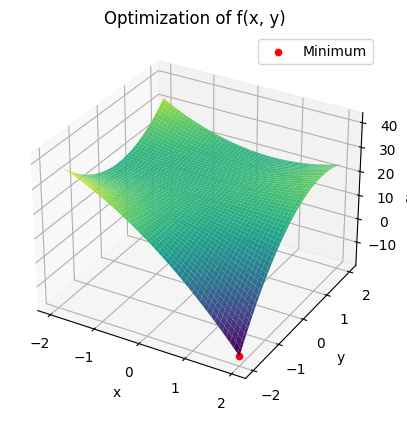

In [3]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

def func(x, y):
    return x**2 * y - 2 * x * y**2 + 3 * x * y + 20

# establishing ranges (100 values in the interval [-2, 2])
x_range = np.linspace(-2, 2, 100)
y_range = np.linspace(-2, 2, 100)
X, Y = np.meshgrid(x_range, y_range)

# evaluating func(x, y) at each combination of grid points
Z = func(X, Y)


fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(X, Y, Z, cmap='viridis')

ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('f(x, y)')
ax.set_title('Optimization of f(x, y)')

# red dot highlighting the minimum point
min_z = func(min_x, min_y)
ax.scatter(min_x, min_y, min_z, color='red', label='Minimum')
plt.legend()
plt.show()

In [4]:
import numpy as np
import plotly.graph_objects as go

# ranges
x_range = np.linspace(-2, 2, 100)
y_range = np.linspace(-2, 2, 100)
X, Y = np.meshgrid(x_range, y_range)

# evaluation of func(x, y) at each combination of grid points
Z = func(X, Y)


fig = go.Figure(data=go.Surface(x=X, y=Y, z=Z))
fig.update_layout(title='Optimization of f(x, y)',
                  scene=dict(xaxis_title='x', yaxis_title='y', zaxis_title='f(x, y)'),
                  autosize=False,
                  width=800, height=600)

# minimum point coordinates
# computing by actual minimum point
min_z = func(min_x, min_y)
fig.add_trace(go.Scatter3d(x=[min_x], y=[min_y], z=[min_z], mode='markers',
                          marker=dict(color='red', size=5), name='Minimum'))

fig.show()


# (5.2)
Use "EuStockMarkets" data set which provides daily closing prices of major European stock indices between 1991 and 1998.

In [5]:
import pandas as pd
import statsmodels.api as sm

# retrieving the "EuStockMarkets" dataset fom statsmodels.api library
# stocks = sm.datasets.get_rdataset('EuStockMarkets').data

stocks = pd.read_csv("https://raw.githubusercontent.com/MarkusStefan/Data_Analytics/main/Exercise5/EuStockMarkets.csv", header=[0], sep=";", index_col=[0])
stocks = stocks.replace(',', '.', regex=True)
stocks = stocks.astype(float)
stocks.head()

,DAX,SMI,CAC,FTSE
1,1628.75,1678.1,1772.8,2443.6
2,1613.63,1688.5,1750.5,2460.2
3,1606.51,1678.6,1718.0,2448.2
4,1621.04,1684.1,1708.1,2470.4
5,1618.16,1686.6,1723.1,2484.7


## (a)

Run OLS estimation of the linear regression between SMI, CAC, FTSE as independent variables and DAX as dependent variable.

In [6]:
from sklearn.linear_model import LinearRegression

# independent variables (SMI, CAC, FTSE)
X = stocks[['SMI', 'CAC', 'FTSE']]
# dependent variable (DAX)
y = stocks['DAX']


model = LinearRegression()

model.fit(X, y)

# estimated coefs
coefficients = model.coef_
intercept = model.intercept_


print("Coefficients:", coefficients)
print("Intercept:", intercept)


Coefficients: [ 0.49277225  0.49565379 -0.01720263]
Intercept: -175.94566831357815


`sm.add_constant` in statsmodel is the same as sklearn's fit_intercept parameter in LinearRegression(). If you don't do sm.add_constant or when LinearRegression(fit_intercept=False), then both statsmodels and sklearn algorithms assume that b=0 in y = mx + b, and it'll fit the model using b=0 instead of calculating what b is supposed to be based on your data.

In [7]:
import pandas as pd
import statsmodels.api as sm


X = stocks[['SMI', 'CAC', 'FTSE']]
y = stocks['DAX']

X = sm.add_constant(X)

# fit model
model = sm.OLS(y, X)
results = model.fit()

print(results.summary())


                            OLS Regression Results                            
Dep. Variable:                    DAX   R-squared:                       0.990
Model:                            OLS   Adj. R-squared:                  0.990
Method:                 Least Squares   F-statistic:                 6.032e+04
Date:                Tue, 13 Jun 2023   Prob (F-statistic):               0.00
Time:                        20:44:53   Log-Likelihood:                -11370.
No. Observations:                1860   AIC:                         2.275e+04
Df Residuals:                    1856   BIC:                         2.277e+04
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       -175.9457     44.666     -3.939      0.0

## (b)
Run the same OLS estimation using differential evolution method. Use the DEoptim function with the following specific options (see R code for unit 6, however, you should be able to explain this setting): (your function, lower = c(−200, −1, −1, −1), upper = c(0, 3, 3, 3), control = list(itermax = 200, trace = 20)). Compare the results with the results in (a) regarding the estimated parameters and the value of the objective function (use anova function as discussed in unit 6).

The objective of OLS is to **minimize** the Sum of Squared Residuals (**SSR**); hence, we must instruct the optimization algorithm to pursue a minimization of the SSR as well!

The SSR is given as follows:
$$
SSR = \sum_{i=1}^n (y_t-\hat{y}_t)^2,
$$
or:
$$
SSR = \sum_{i=1}^n (y_t - \beta_0 - \beta_1x_1- \beta_2x_x - \dots - \beta_j x_j)^2
$$

In [8]:
from numba.np.numpy_support import is_array
import numpy as np
import pandas as pd
from scipy.optimize import differential_evolution
import statsmodels.api as sm
import random

# set a seed for replication purposes
random.seed(999_999)

stocks = sm.datasets.get_rdataset('EuStockMarkets').data
y = stocks['DAX']
X = sm.add_constant(stocks[['SMI', 'CAC', 'FTSE']])

# objective is to minimize sum of squared resids
def ols_objective_func(params, X, y):
    beta = params
    # LINEAR ALGEBRA: dot product multiplies each beta_j with corresponding x_j
    y_pred = np.dot(X, beta)
    # same can be achieved by individuel list unpacking and writing the equation
    if not is_array(y_pred):
      const, smi_coef, cac_coef, ftse_coef = params
      y_pred = const + smi_coef * X.iloc[:, 0] + cac_coef * X.iloc[:, 1] + ftse_coef * X.iloc[:, 2]

    residuals = y - y_pred
    ssr = np.sum(residuals**2) # sum of squared residuals
    return ssr


def de_optim(objective_func, bounds:list, args:tuple, options:dict):
  de = differential_evolution(objective_func, bounds, args=args, **options)
  return de



# bounds for the parameters
# (lb beta0, ub beta0), (lb beta1, ub beta1),
# (lb beta2, ub beta2), (lb beta3, ub beta3)
bounds = [(-200, 0), (-1, 3), (-1, 3), (-1, 3)]

# max iterations & values displayed
options = {'maxiter': 200, 'disp': 20}

# applying the optimization
optimum = de_optim(ols_objective_func, bounds, args=(X,y), options=options)

# unpacking optimized params
beta_0, beta_1, beta_2, beta_3 = optimum.x

# extracting optimization objective, that is, SSR
optimized_ssr = optimum.fun

# true OLS model for comparison
model = sm.OLS(y, X)
blue = model.fit()
ols_ssr = np.sum(blue.resid**2)

output.clear()

print("\nResults using differential evolution:")
print("Estimated Parameters:")
print(f"Intercept\t{beta_0}")
print(f"SMI  \t{beta_1}")
print(f"CAC  \t{beta_2}")
print(f"FTSE  \t{beta_3}")

#print("\nResults from OLS estimation in (a):")
#print(blue.summary())

print("\n\nOLS fitted parameters:")
print(blue.params)

print("Optimized SSR:\t%.3f" %optimized_ssr)
print("OLS SSR: \t%.3f" %ols_ssr)


Results using differential evolution:
Estimated Parameters:
Intercept	-175.2467072877881
SMI  	0.4930058201230682
CAC  	0.4954750230090281
FTSE  	-0.017507501482180592


OLS fitted parameters:
const   -175.945668
SMI        0.492772
CAC        0.495654
FTSE      -0.017203
dtype: float64
Optimized SSR:	22209223.699
OLS SSR: 	22209220.769


In the above code, params in weighted_ols_objective_func will receive the array of parameters during the optimization process. The length and order of the params array will correspond to the bounds you specified in the bounds argument when calling differential_evolution.

In [9]:
from statsmodels.stats.anova import anova_lm

y = stocks['DAX']
X = stocks[['SMI', 'CAC', 'FTSE']]

X = sm.add_constant(X)

model = sm.OLS.from_formula('DAX ~ SMI + CAC + FTSE', data=stocks)

blue = model.fit()

# ANOVA (ANalysis Of VAriance) test
anova_results = anova_lm(blue, typ=3) # two-way anova



print("Results using Differential Evolution:")
print(f"Intercept: {beta_0}")
print(f"SMI: {beta_1}")
print(f"CAC: {beta_2}")
print(f"FTSE: {beta_3}")

print("\n\nOLS fitted parameters:")
print(blue.params)

print("\n\nANOVA table:")
print(anova_results)


Results using Differential Evolution:
Intercept: -175.2467072877881
SMI: 0.4930058201230682
CAC: 0.4954750230090281
FTSE: -0.017507501482180592


OLS fitted parameters:
Intercept   -175.945668
SMI            0.492772
CAC            0.495654
FTSE          -0.017203
dtype: float64


ANOVA table:
                 sum_sq      df            F         PR(>F)
Intercept  1.856794e+05     1.0    15.517021   8.479065e-05
SMI        1.237836e+07     1.0  1034.446149  9.020895e-181
CAC        1.233366e+07     1.0  1030.710373  2.999041e-180
FTSE       8.113363e+03     1.0     0.678025   4.103735e-01
Residual   2.220922e+07  1856.0          NaN            NaN


ANOVA Table:

+ The ANOVA table provides information about the significance of the variables.
+ For SMI and CAC, the p-values (PR(>F)) are very small (close to zero), indicating that these variables have a statistically significant impact on the dependent variable.
+ The high F-statistic values further support their significance.
+ For FTSE, the p-value is 0.4104, which is relatively high. This suggests that the variable may not have a statistically significant impact on the dependent variable. The low F-statistic value also supports this observation.
+ The "Residual" row represents the sum of squared residuals, which measures the unexplained variation in the dependent variable after accounting for the independent variables. Higher values indicate more unexplained variation.

We can conclude that the results from differential evolution and the OLS estimation are very similar, with almost identical parameter estimates.
The ANOVA table confirms the significance of SMI and CAC in explaining the variation in the dependent variable (DAX), while FTSE appears to be less significant.

# (5.3)



## (a)
Run a weighted linear regression between SMI, CAC, FTSE as independent variables and DAX as dependent variable using DE and particle swarm optimization methods. "Weighted" means in this case that you should use the same function as in exercise 5.2, however the weight of the independent variable CAC should be set to 2, i.e. y = β0 + β1x1 + 2β2x2 + β3x3. For particle swarm optimization, use the psoptim function with the following options (see R code for unit 6, however, you should be able to explain this setting):

(rep(NA, 4), your function, lower = c(−200, −1, −1, −1), upper = c(0, 3, 3, 3), control = list(maxit = 200, trace = 1, REP ORT = 20)).

In [10]:
!pip install pyswarm
!pip install pyswarms

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/




```
library(optimx)
library(psoptim)
library(mvtnorm)

data(EuStockMarkets)
data = as.data.frame(EuStockMarkets)
attach(data)

# Weighted linear regression using DE method
w <- c(1, 2, 1) # weight vector
f <- function(beta) sum(w * (DAX - beta[1] - beta[2] * SMI - beta[3] * CAC / 2 - beta[4] * FTSE)^2)
res <- optimx(c(0, 0, 0, 0), f, method = "DEoptim", lower = c(-200, -1, -1, -1), upper = c(0, 3, 3, 3), control = list(maxit = 200))

# Weighted linear regression using particle swarm optimization method
f <- function(beta) sum(w * (DAX - beta[1] - beta[2] * SMI - beta[3] * CAC / 2 - beta[4] * FTSE)^2)
res <- psoptim(c(0, 0, 0, 0), f, lower = c(-200, -1, -1, -1), upper = c(0, 3, 3, 3), control = list(maxit = 200, trace = 1, REPORT = 20))
```



In [11]:
stocks = sm.datasets.get_rdataset('EuStockMarkets').data
X = stocks[['SMI', 'CAC', 'FTSE']]
y = stocks['DAX']
X*[1,2,1]

,SMI,CAC,FTSE
0,1678.1,3545.6,2443.6
1,1688.5,3501.0,2460.2
2,1678.6,3436.0,2448.2
3,1684.1,3416.2,2470.4
4,1686.6,3446.2,2484.7
...,...,...,...
1855,7721.3,7879.0,5587.6
1856,7447.9,7692.0,5432.8
1857,7607.5,7891.4,5462.2
1858,7552.6,7903.4,5399.5


In [12]:
from numba.np.numpy_support import is_array
import numpy as np
import pandas as pd
from scipy.optimize import differential_evolution
import statsmodels.api as sm
import random

# set a seed for replication purposes
random.seed(999_999)

stocks = sm.datasets.get_rdataset('EuStockMarkets').data
y = stocks['DAX']
X = sm.add_constant(stocks[['SMI', 'CAC', 'FTSE']])


# objective is to minimize sum of squared resids
def weighted_objective_func(params, X, y):
    beta = params
    # LINEAR ALGEBRA: dot product multiplies each beta_j with corresponding x_j
    y_pred = np.dot(X*[1,1,2,1], beta) # adding weights
    residuals = y - y_pred
    ssr = np.sum(residuals**2)
    return ssr


###################### Differential Evolution (DE) #############################
def de_optim(objective_func, bounds:list, args:tuple, options:dict):
  de = differential_evolution(objective_func, bounds, args=args, **options)
  return de


# bounds for beta parameters (lb beta0, ub beta0), (lb beta1, ub beta1),
# (lb beta2, ub beta2), (lb beta3, ub beta3)
de_bounds = [(-200, 0), (-1, 3), (-1, 3), (-1, 3)]
# maximum iterations, display of debugging, tolerance of convergence
# -> terminates once converged smaller than value passed in
de_options = {'maxiter': 200, 'disp': True, 'tol': 1e-6}


de_optimum = de_optim(weighted_objective_func, de_bounds, args=(X,y), options=de_options)

# unpacking optimized params
beta_0, beta_1, beta_2, beta_3 = optimum.x

de_optimized_ssr = de_optimum.fun


print("\n", "-"*50, "\n")
print("-"*50, "\n")
################# Particle Swarm Optimization (PSO) ############################
pso_options = {'maxiter': 200, 'debug': True, 'minfunc': 1e-6}

def ps_optim(objective_func, lower_bound:list, upper_bound:list, arguments:tuple, options:dict):
  ps = pyswarm.pso(objective_func , lb=lower_bound, ub=upper_bound,  args=arguments, **options)
  return ps
#pso_optimum = pyswarm.pso(weighted_objective_func, args=(X,y), lb=[-200, -1, -1, -1], ub=[0,3,3,3], **pso_options)

pso_optimum = ps_optim(objective_func=weighted_objective_func, lower_bound=[-200, -1, -1, -1], upper_bound=[0,3,3,3], arguments=(X,y), options=pso_options )




########################## OLS Regression ######################################

# true OLS model for comparison
model = sm.OLS(y, X*[1,1,2,1])
#X = sm.add_constant(X)
#model = sm.OLS.from_formula('DAX ~ SMI + CAC + CAC + FTSE', data=stocks) # still yields same results as unweighted formula
blue = model.fit()
ols_ssr = np.sum(blue.resid**2)

output.clear()

################################################################################

print("\n\nResults Differential Evolution:")
print("Estimated Parameters:")
print(f"Intercept: {beta_0}")
print(f"SMI: {beta_1}")
print(f"CAC: {beta_2}")
print(f"FTSE: {beta_3}")
print("DE SSR:", de_optimized_ssr)

print("\n\nResults Particle Swarm Optimization:")
print("Estimated Parameters:")
print(f"Intercept: {pso_optimum[0][0]}")
print(f"SMI: {pso_optimum[0][1]}")
print(f"CAC: {pso_optimum[0][2]}")
print(f"FTSE: {pso_optimum[0][3]}")
print("PSO SSR:", pso_optimum[1])

print("\n\nOLS fitted parameters:")
print(blue.params)
print("OLS SSR: \t%.3f" %ols_ssr)

de_diff, pso_diff = (de_optimized_ssr - ols_ssr), (pso_optimum[1] - ols_ssr)
print("\n", "-"*50, "\nABSOLUTE DIFFERENCES:")
print("\n DE SSR - OLS SSR:\t%.3f" %de_diff)
print("\nPSO SSR - OLS SSR:\t%.3f" %pso_diff)


print("-"*50)
if pso_diff > de_diff:
  print("PSO performs worse than DE")
elif pso_diff < de_diff:
  print("DE performs worse than PSO")
else:
  print("Both algorithms perform equally well")



Results Differential Evolution:
Estimated Parameters:
Intercept: -175.2467072877881
SMI: 0.4930058201230682
CAC: 0.4954750230090281
FTSE: -0.017507501482180592
DE SSR: 22209220.94077058


Results Particle Swarm Optimization:
Estimated Parameters:
Intercept: -95.72529828959624
SMI: 0.5202420202634458
CAC: 0.23742776165765425
FTSE: -0.05269337140858548
PSO SSR: 22248285.951069422


OLS fitted parameters:
const   -175.945668
SMI        0.492772
CAC        0.247827
FTSE      -0.017203
dtype: float64
OLS SSR: 	22209220.769

 -------------------------------------------------- 
ABSOLUTE DIFFERENCES:

 DE SSR - OLS SSR:	0.172

PSO SSR - OLS SSR:	39065.182
--------------------------------------------------
PSO performs worse than DE


In [13]:
import numpy as np
from scipy.optimize import differential_evolution
import pyswarm
import statsmodels.api as sm
from google.colab import output

# random seed for replication
np.random.seed(999_999)

stocks = sm.datasets.get_rdataset('EuStockMarkets').data
y = stocks['DAX']
X = stocks[['SMI', 'CAC', 'FTSE']]
X = sm.add_constant(stocks[['SMI', 'CAC', 'FTSE']])

# def weighted_objective_func(x):
#     sigma = np.sum(stocks['DAX'] - x[0] - x[1]*stocks['SMI'] - 2*x[2]*stocks['CAC'] - x[3]*stocks['FTSE'])
#     ssr = sigma **2
#     return ssr

def weighted_objective_func(params, X, y):
    y_pred = stocks['DAX'] - params[0] + params[1]*stocks['SMI'] + 2*params[2]*stocks['CAC'] + params[3]*stocks['FTSE']
    ssr = np.sum((y_pred-y)**2)
    return ssr

###################### Differential Evolution (DE) #############################
de_bounds = [(-200, 0), (-1, 3), (-1, 3), (-1, 3)]
de_options = {'maxiter': 200, 'disp': 1, 'tol': 1e-6}

# differential_evolution optimization
#de_optimum = differential_evolution(weighted_objective_func, de_bounds, **de_options)
de_optimum = de_optim(weighted_objective_func, de_bounds, args=(X,y), options=de_options)
# unpacking outputs
de_params = de_optimum.x
beta_0, beta_1, beta_2, beta_3 = de_optimum.x
de_optimized_ssr = de_optimum.fun


print("-"*50)
################# Particle Swarm Optimization (PSO) ############################
pso_options = {'maxiter': 200, 'debug': True, 'minfunc': 1e-6}

#pso_optimum= pyswarm.pso(objective_func, bounds[0], bounds[1], **pso_options)
#pso_optimum = pyswarm.pso(weighted_objective_func, lb=[-200, -1, -1, -1], ub=[0,3,3,3], **pso_options)
pso_optimum = pyswarm.pso(weighted_objective_func, args=(X,y), lb=[-200, -1, -1, -1], ub=[0,3,3,3], **pso_options)



########################## OLS Regression ######################################
y = stocks['DAX']
X = stocks[['SMI', 'CAC', 'FTSE']]

X = sm.add_constant(X)

model = sm.OLS.from_formula('DAX ~ SMI + CAC + CAC + FTSE', data=stocks) # still yields same results as unweighted formula
blue = model.fit()
ols_ssr = np.sum(blue.resid**2)

# clearing the output
output.clear()

print("\n\nResults Differential Evolution:")
print("Estimated Parameters:")
# print(f"Intercept: {de_params[0]}")
# print(f"SMI: {de_params[1]}")
# print(f"CAC: {de_params[2]}")
# print(f"FTSE: {de_params[3]}")

print(f"Intercept: {beta_0}")
print(f"SMI: {beta_1}")
print(f"CAC: {beta_2}")
print(f"FTSE: {beta_3}")
print("DE SSR:", de_optimized_ssr)

print("\n\nResults Particle Swarm Optimization:")
print("Estimated Parameters:")
print(f"Intercept: {pso_optimum[0][0]}")
print(f"SMI: {pso_optimum[0][1]}")
print(f"CAC: {pso_optimum[0][2]}")
print(f"FTSE: {pso_optimum[0][3]}")
print("PSO SSR:", pso_optimum[1])

print("\n\nOLS fitted parameters:")
print(blue.params)
print("OLS SSR: \t%.3f" %ols_ssr)

de_diff, pso_diff = (de_optimized_ssr - ols_ssr), (pso_optimum[1] - ols_ssr)
print("\n", "-"*50, "\nABSOLUTE DIFFERENCES:")
print("\n DE SSR - OLS SSR:\t%.3f" %de_diff)
print("\nPSO SSR - OLS SSR:\t%.3f" %pso_diff)



Results Differential Evolution:
Estimated Parameters:
Intercept: -1.1109152225685648e-05
SMI: 1.48199652549863e-09
CAC: 4.2031329527958405e-09
FTSE: -9.988089688661717e-09
DE SSR: 2.5364525910179055e-08


Results Particle Swarm Optimization:
Estimated Parameters:
Intercept: -82.34863886366716
SMI: 0.02773896529353165
CAC: -0.01050526471497156
FTSE: -0.03618986110428595
PSO SSR: 40734.51624124182


OLS fitted parameters:
Intercept   -175.945668
SMI            0.492772
CAC            0.495654
FTSE          -0.017203
dtype: float64
OLS SSR: 	22209220.769

 -------------------------------------------------- 
ABSOLUTE DIFFERENCES:

 DE SSR - OLS SSR:	-22209220.769

PSO SSR - OLS SSR:	-22168486.252


2023-06-13 20:49:17,770 - pyswarms.single.global_best - INFO - Optimize for 100 iters with {'c1': 0.5, 'c2': 0.3, 'w': 0.9}
pyswarms.single.global_best: 100%|██████████|100/100, best_cost=7.18e-10
2023-06-13 20:49:18,160 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 7.184191679002805e-10, best pos: [-2.58107700e-05 -7.22657042e-06]
2023-06-13 20:49:24,397 - matplotlib.animation - INFO - Animation.save using <class 'matplotlib.animation.HTMLWriter'>
2023-06-13 20:49:36,021 - matplotlib.animation - WARNING - Animation size has reached 21122054 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


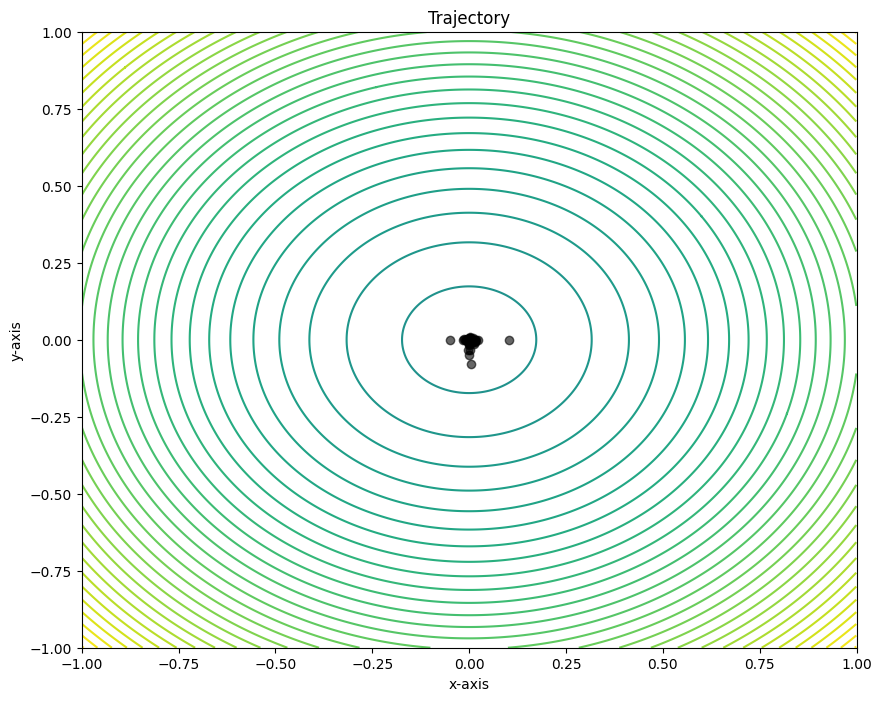

In [15]:
from matplotlib import rc
rc('animation', html='jshtml')
import pyswarms as ps
from pyswarms.utils.functions import single_obj as fx
from pyswarms.utils.plotters import plot_cost_history, plot_contour, plot_surface
import matplotlib.pyplot as plt
from pyswarms.utils.plotters.formatters import Mesher, Designer

options = {'c1':0.5, 'c2':0.3, 'w':0.9}
optimizer = ps.single.GlobalBestPSO(n_particles=50, dimensions=2, options=options)
optimizer.optimize(fx.sphere, iters=100)

# plot the sphere function's mesh for better plots
m = Mesher(func=fx.sphere,
           limits=[(-1,1), (-1,1)])
# adjust figure limits
d = Designer(limits=[(-1,1), (-1,1), (-0.1,1)],
             label=['x-axis', 'y-axis', 'z-axis'])

plot_contour(pos_history=optimizer.pos_history, mesher=m, designer=d, mark=(0,0))

# (5.4)
Use "marketing" data set.


In [17]:
import pandas as pd

market = pd.read_csv('https://raw.githubusercontent.com/MarkusStefan/Data_Analytics/main/Exercise5/marketing.csv', header=[0], index_col=[0])
print(market.head())
# descriptive statistics
print(market.describe())

   youtube  facebook  newspaper  sales
1   276.12     45.36      83.04  26.52
2    53.40     47.16      54.12  12.48
3    20.64     55.08      83.16  11.16
4   181.80     49.56      70.20  22.20
5   216.96     12.96      70.08  15.48
          youtube    facebook   newspaper       sales
count  200.000000  200.000000  200.000000  200.000000
mean   176.451000   27.916800   36.664800   16.827000
std    103.025084   17.816171   26.134345    6.260948
min      0.840000    0.000000    0.360000    1.920000
25%     89.250000   11.970000   15.300000   12.450000
50%    179.700000   27.480000   30.900000   15.480000
75%    262.590000   43.830000   54.120000   20.880000
max    355.680000   59.520000  136.800000   32.400000


## (a)
Run k-means clustering analysis with 2 clusters. Which cluster would you denote as potentially "high marketing activity"/"low marketing activity" cluster?

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



            youtube   facebook  newspaper      sales  Cluster
Cluster                                                      
0         84.486122  26.331429  35.551837  12.513061      0.0
1        264.809412  29.440000  37.734118  20.971765      1.0


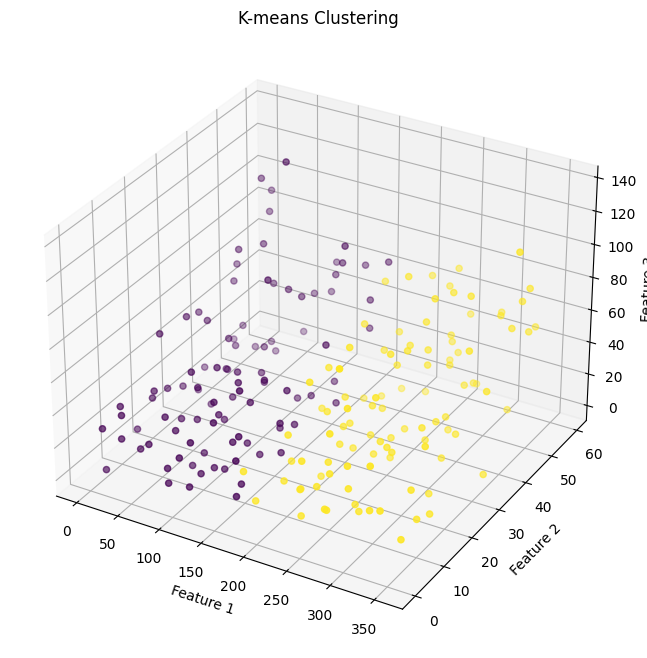

In [18]:
import pandas as pd
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt


kmeans = KMeans(n_clusters=2, random_state=999_999)
kmeans.fit(market)

# labelling data points according to cluster
labels = kmeans.labels_


market['Cluster'] = labels

# Calculate the mean of each feature by cluster
cluster_means = market.groupby('Cluster')[market.columns].mean()

# Print the cluster means
print(cluster_means)

# Create a 3D plot
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot the data points with different colors for each cluster
ax.scatter(market.iloc[:, 0], market.iloc[:, 1], market.iloc[:, 2], c=labels, cmap='viridis')

# Set labels and title
ax.set_xlabel('Feature 1')
ax.set_ylabel('Feature 2')
ax.set_zlabel('Feature 3')
ax.set_title('K-means Clustering')

# Show the plot
plt.show()


In [19]:
import plotly.express as px

fig = px.scatter_3d(market, x=market.columns[0], y=market.columns[1], z=market.columns[2], color='Cluster')


fig.update_layout(scene=dict(xaxis_title=market.columns[0],
                             yaxis_title=market.columns[1],
                             zaxis_title=market.columns[2]),
                  title='K-means Clustering')
fig.show()





## (b)
Create a neural network to run the cluster analysis with marketing data. Split the data set, with first 90% of observations used as the training data set and the remaining 10% as the prediction data set. Compare the predicted clusters with the results from (a).

In [21]:
# data previes
market.iloc[-10:,:]

,youtube,facebook,newspaper,sales,Cluster
191,47.40,49.32,6.96,12.96,0
192,90.60,12.96,7.20,11.88,0
193,20.64,4.92,37.92,7.08,0
194,200.16,50.40,4.32,23.52,1
195,179.64,42.72,7.20,20.76,1
196,45.84,4.44,16.56,9.12,0
197,113.04,5.88,9.72,11.64,0
198,212.40,11.16,7.68,15.36,1
199,340.32,50.40,79.44,30.60,1
200,278.52,10.32,10.44,16.08,1


I use the accuracy metric for measuring the models' performance:

$$
\text{Accuracy Score} = \frac{\text{Number of Correct Predictions}}{\text{Number of Total Predictions made}}
$$

*Note:*
+ TensorFlow-Keras-API already implements backpropagation (adjusting weights by nested derivative [gradient descent])
+ in the output layer, we have 1 neuron which fires due to the Sigmoid function as activation, since it squeezes the output between 1 and 0
+ since we get probabilities as output, we do some data engineering by rounding... everything below 0.5 will converge to 0, and everything equal to or above 0.5 to 1


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 128)               640       
                                                                 
 dense_1 (Dense)             (None, 64)                8256      
                                                                 
 dense_2 (Dense)             (None, 32)                2080      
                                                                 
 dense_3 (Dense)             (None, 16)                528       
                                                                 
 dense_4 (Dense)             (None, 8)                 136       
                                                                 
 dense_5 (Dense)             (None, 1)                 9         
                                                                 
Total params: 11,649
Trainable params: 11,649
Non-traina

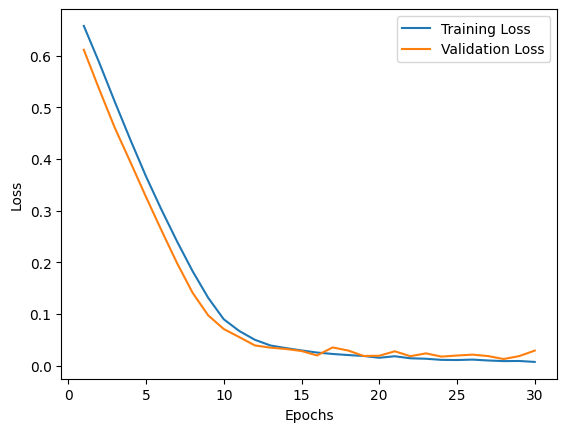

In [22]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from keras.models import Sequential
from keras.layers import Dense
from sklearn.metrics import accuracy_score

# Prepare the feature matrix and target labels
X = market.iloc[:, :-1].values
y = market['Cluster'].values

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42)

# Scale the features using standardization
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Build the neural network model
model = Sequential()
model.add(Dense(128, input_dim=X_train_scaled.shape[1], activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(8, activation='relu'))
model.add(Dense(1, activation='sigmoid'))



# compilation of model -> we use binary_crossentropy bc we have two classes
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

print(model.summary())

history = model.fit(X_train_scaled, y_train, validation_data=(X_test_scaled, y_test), epochs=30, batch_size=32, verbose=1)


# # Perform prediction on the test set
# predictions = model.predict(X_test_scaled)



# Make predictions on the prediction dataset
predictions = model.predict(X_test_scaled).flatten()

# theshold of 0.5 for establishing binary outputs
# result = np.copy(predictions)
# result[result >= 0.5] = 1
# result[result < 0.5] = 0
predict_clust = np.where(predictions > 0.5, 1, 0)

# Compare predicted clusters with k-means clustering results
accuracy = accuracy_score(y_test, predict_clust)

print("Accuracy of predicted clusters (Neural Network):", accuracy)



train_loss = history.history['loss']
val_loss = history.history['val_loss']
plt.plot(range(1, len(train_loss) + 1), train_loss, label="Training Loss")
plt.plot(range(1, len(val_loss) + 1), val_loss, label="Validation Loss")
plt.xlabel('Epochs')
plt.ylabel('Loss')
#plt.title('Loss Curves')
plt.legend()
plt.show()




The accuracy score is 1, meaning that $\frac{20 \text{ correct predictions}}{20 \text{ total test predictions}}$

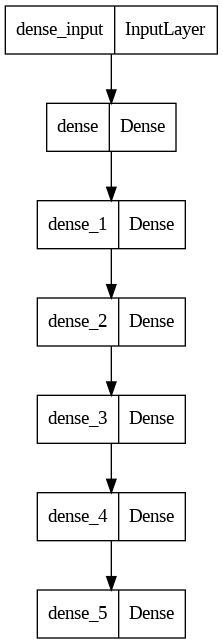

In [23]:
from keras.utils import plot_model
plot_model(model)

In [24]:
!pip install ann_visualizer visualkeras graphviz

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


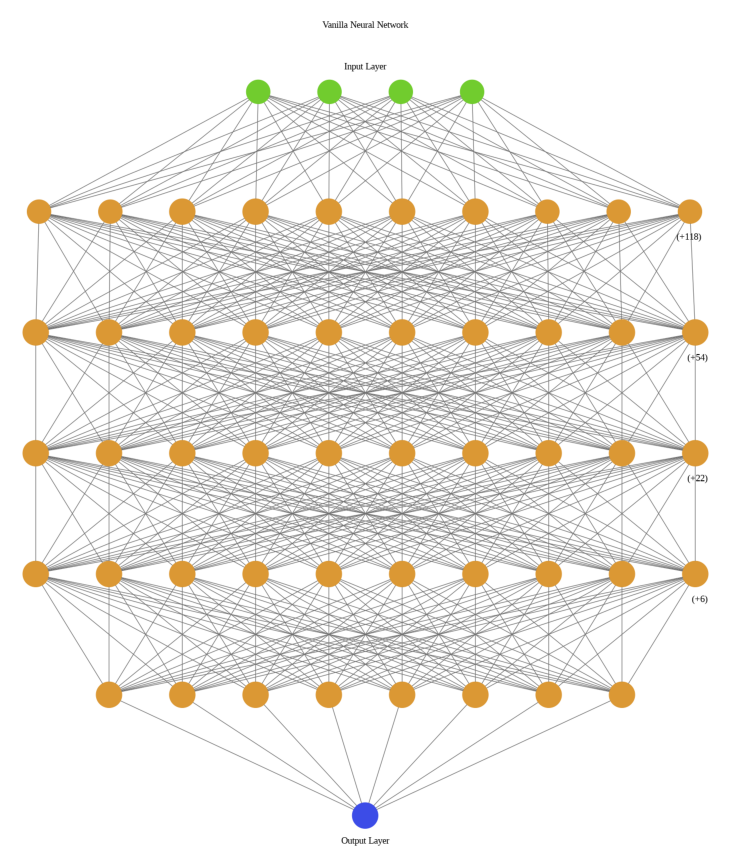

In [25]:
import os
from google.colab.patches import cv2_imshow
import cv2
from ann_visualizer.visualize import ann_viz
import graphviz
import os

# increase figure size
plt.figure(figsize=(15, 11))

ann_viz(model, view=True, filename="VanillaNeuralNetwork.txt", title="Vanilla Neural Network")
file_path = os.path.join(os.getcwd(), "VanillaNeuralNetwork.txt")


with open(file_path, "r") as file:
    vizz = file.read()

vizz = graphviz.Source(vizz)
vizz.format = 'png'
vizz.render('VanillaNeuralNetwork', view=True)

img = cv2.imread("VanillaNeuralNetwork.png")
# remove axis
plt.axis('off')
plt.imshow(img)


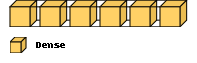

In [26]:
import visualkeras
from PIL import ImageFont

visualkeras.layered_view(model, legend=True)

In [27]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 128)               640       
                                                                 
 dense_1 (Dense)             (None, 64)                8256      
                                                                 
 dense_2 (Dense)             (None, 32)                2080      
                                                                 
 dense_3 (Dense)             (None, 16)                528       
                                                                 
 dense_4 (Dense)             (None, 8)                 136       
                                                                 
 dense_5 (Dense)             (None, 1)                 9         
                                                                 
Total params: 11,649
Trainable params: 11,649
Non-traina

# (5.5)
Use “countries data” data set (from practical unit 3) which provides socioeconomic profiles of countries in 2020.

In [28]:
import pandas as pd

countries = pd.read_csv("https://raw.githubusercontent.com/MarkusStefan/Data_Analytics/main/Exercise3/countries_data1.csv", header=[0], index_col=[0])
countries

,population,life_expect,fertility,fertility_adol,mortal_5,mobile_phones,migration,electricity,gdp,inflation,pop_growth,surface_area,unemployment_rate
country,,,,,,,,,,,,,
Afghanistan,38972230.0,62.58,4.75,84.30,57.8,58.19,166821.0,97.70,553.04,5.60,3.13,652860.0,11.71
Albania,2837849.0,76.99,1.40,14.67,9.4,91.35,-9117.0,100.00,4410.46,1.62,-0.57,28750.0,13.07
Algeria,43451666.0,74.45,2.94,12.06,22.9,104.84,-18797.0,99.80,3873.51,2.42,1.73,2381741.0,12.25
Angola,33428486.0,62.26,5.37,139.83,72.1,43.81,7557.0,46.89,2347.79,22.27,3.27,1246700.0,10.35
Argentina,45376763.0,75.89,1.91,39.87,7.7,121.60,2344.0,100.00,11341.27,42.02,0.97,2780400.0,11.46
...,...,...,...,...,...,...,...,...,...,...,...,...,...
Vanuatu,311685.0,70.30,3.78,64.86,24.0,79.00,-197.0,67.33,2623.05,5.33,2.36,12190.0,2.02
Vietnam,96648685.0,75.38,1.96,34.71,20.9,143.75,-2016.0,100.00,3352.06,3.22,0.91,331340.0,2.10
West Bank and Gaza,4803269.0,74.40,3.57,44.53,15.3,79.63,-12369.0,100.00,2922.47,-0.74,2.49,6020.0,25.89


## (a)
Select a subset of the whole data set with only 5 variables/indicators. Run
k-means clustering analysis with 2 clusters using the selected subset. Which
cluster would you denote as potentially “advanced economies”/ “developing
economies” cluster?

In [29]:
# first 5 rows as features
#subset = countries.iloc[:, -5:]
subset = countries.iloc[:, 1:6]
subset

,life_expect,fertility,fertility_adol,mortal_5,mobile_phones
country,,,,,
Afghanistan,62.58,4.75,84.30,57.8,58.19
Albania,76.99,1.40,14.67,9.4,91.35
Algeria,74.45,2.94,12.06,22.9,104.84
Angola,62.26,5.37,139.83,72.1,43.81
Argentina,75.89,1.91,39.87,7.7,121.60
...,...,...,...,...,...
Vanuatu,70.30,3.78,64.86,24.0,79.00
Vietnam,75.38,1.96,34.71,20.9,143.75
West Bank and Gaza,74.40,3.57,44.53,15.3,79.63


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

<ipython-input-30-64e98af97ab6>:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



         life_expect  fertility  fertility_adol   mortal_5  mobile_phones  \
Cluster                                                                     
0          76.137315   1.855648       22.766574  10.712037     121.772407   
1          63.973846   4.009231       90.558269  56.084615      80.669038   

         Cluster  
Cluster           
0            0.0  
1            1.0  


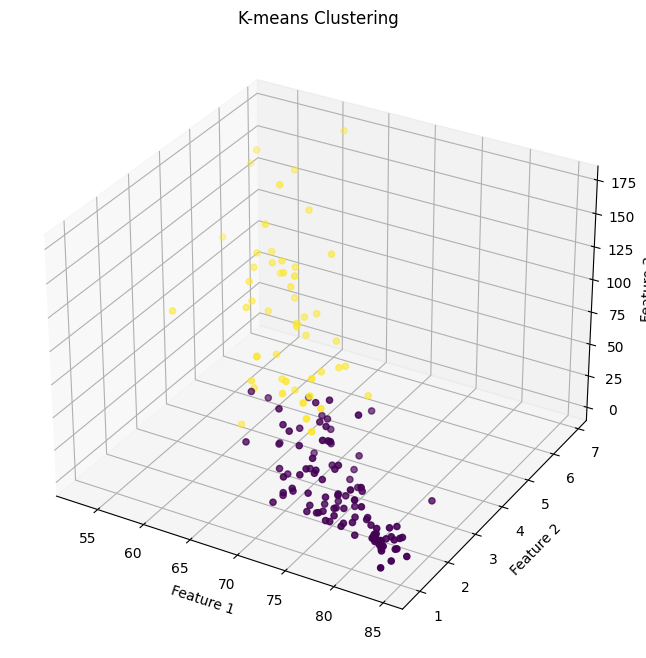

In [30]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=2, random_state=999_999)
kmeans.fit(subset)

labels = kmeans.labels_

subset['Cluster'] = labels

# x_bar of each feature by cluster
cluster_means = subset.groupby('Cluster')[subset.columns].mean()

print(cluster_means)


fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')


ax.scatter(subset.iloc[:, 0], subset.iloc[:, 1], subset.iloc[:, 2], c=labels, cmap='viridis')

ax.set_xlabel('Feature 1')
ax.set_ylabel('Feature 2')
ax.set_zlabel('Feature 3')
ax.set_title('K-means Clustering')

plt.show()


import plotly.express as px

fig = px.scatter_3d(subset, x=subset.columns[0], y=subset.columns[1], z=subset.columns[2], color='Cluster')


fig.update_layout(scene=dict(xaxis_title=subset.columns[0],
                             yaxis_title=subset.columns[1],
                             zaxis_title=subset.columns[2]),
                  title='K-means Clustering')

fig.show()



## (b)
Create a decision tree (rpart function from unit 6) to run the cluster analysis
with countries data data. Split the data set, with 90% of observations used as
the training data set and the remaining 10% as the prediction data set. Compare
the predicted clusters with the results from (a).

Achieved accuracy:	1.000


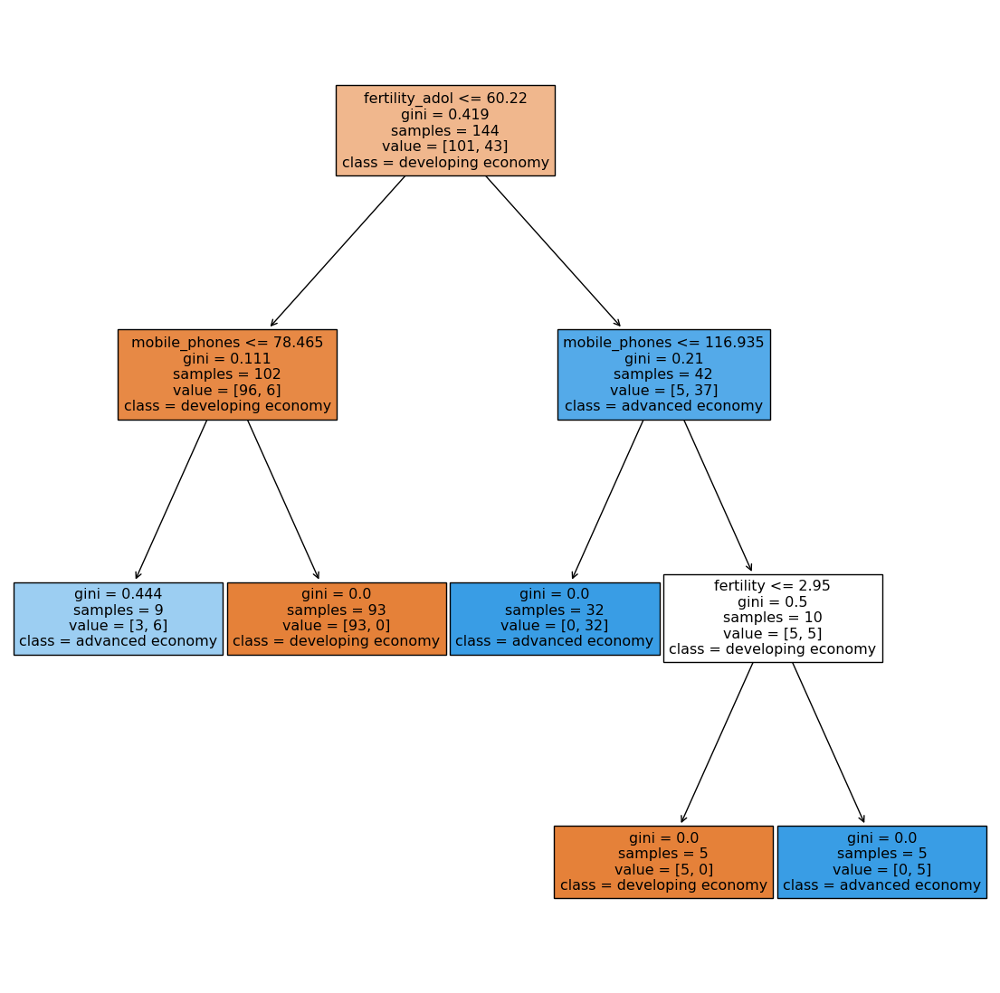

In [32]:
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree
from sklearn.metrics import accuracy_score


# Prepare the feature matrix and target labels
X = subset.iloc[:, :-1].values
y = subset['Cluster'].values

# 90% train 10% test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42)

# prediction based on min. 5 terminal nodes (leaves) & 3 parent nodes (depth of 3)
dtree = DecisionTreeClassifier(criterion="gini", random_state=42, max_depth=3, min_samples_leaf=5)

dtree.fit(X_train, y_train)


prediction = dtree.predict(X_test)

# evaluating accuracy from the true actual cluster and the predicted cluster
accuracy = accuracy_score(y_test, prediction)



print("Achieved accuracy:\t%.3f" %accuracy)


fig = plt.figure(figsize=(14,14))
_ = tree.plot_tree(dtree,
                   feature_names=subset.columns[:-1],
                   class_names=("developing economy", "advanced economy"), #subset.columns[-1],
                   filled=True)


Entropy is a scientific concept as well as a measurable physical property that is most commonly associated with a state of disorder, randomness, or uncertainty.

#### Gini Index in Decision Tree Classifier:

The other way of splitting a decision tree is via the Gini Index. The Entropy and Information Gain method focuses on purity and impurity in a node. The Gini Index or Impurity measures the probability for a random instance being misclassified when chosen randomly. The lower the Gini Index, the better the lower the likelihood of misclassification.

$$ Gini = 1 - \sum_{i=0}^n P(i)^2,$$
whereby n represents the number of classes in the target variable (in our case, 2), and $P(i)$ represents the ratio of $\frac{Pass}{Total}$ of observations in a corresponding node. The highest level of purity is 0, and the maximum value of the Gini Index of 0.5 indicates that there is an random assignment of classes.


The sample counts that are shown are weighted with any sample_weights that might be present.